In [1]:
from daam import trace, set_seed
from diffusers import DiffusionPipeline
from matplotlib import pyplot as plt
import torch
import math

/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
MODEL_ID = "stabilityai/stable-diffusion-xl-base-1.0"
DEVICE = "mps"

In [3]:
pipe = DiffusionPipeline.from_pretrained(
    MODEL_ID,
    use_auth_token=True,
    torch_dtype=torch.float32,
)
pipe = pipe.to(DEVICE)
gen = set_seed(0)

/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/huggingface_hub/file_download.py:1142: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Loading pipeline components...: 100%|██████████| 7/7 [00:00<00:00,  9.71it/s]


  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:32<00:00,  1.86s/it]


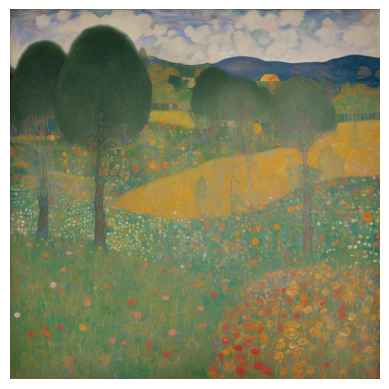

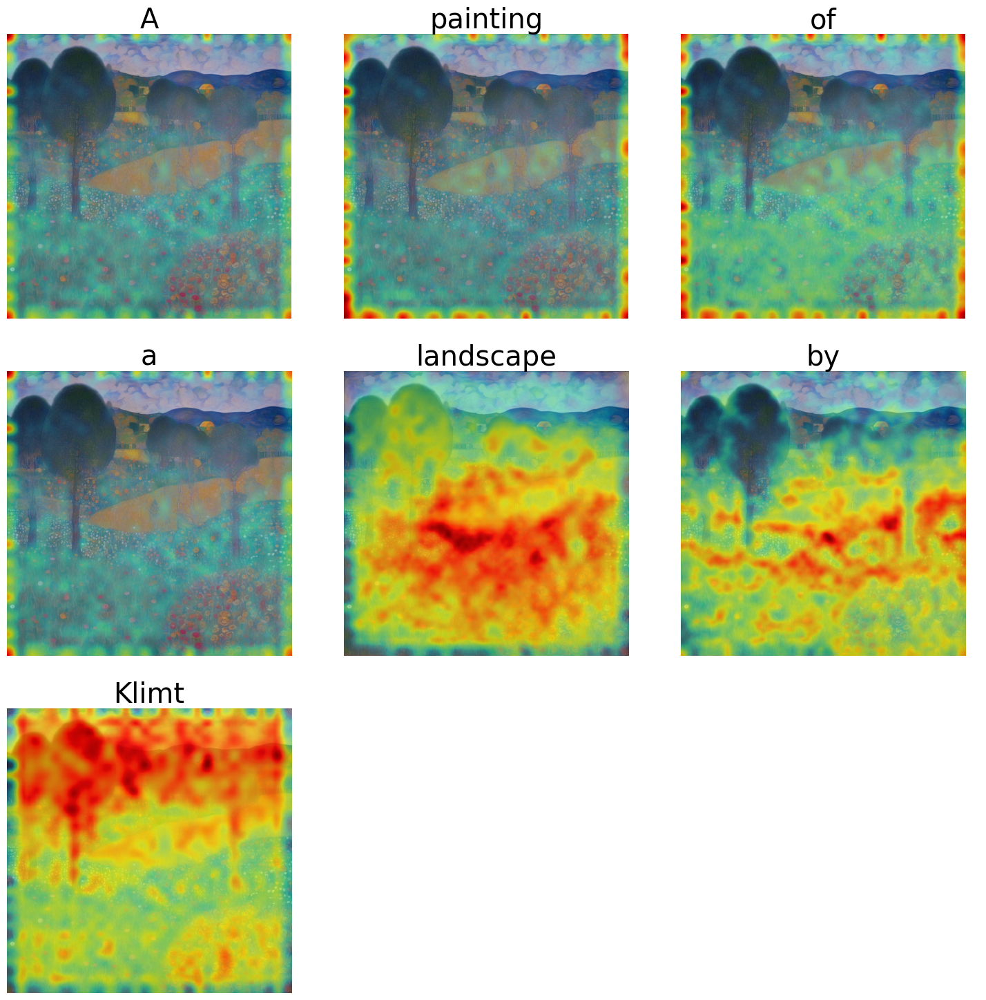

In [ ]:
prompt = "A painting of a landscape by Klimt"

heatmaps = []

with torch.no_grad():
    with trace(pipe) as tc:
        out = pipe(prompt, num_inference_steps=50, generator=gen)
        plt.imshow(out.images[0])
        plt.axis('off')
        plt.show()
        global_heat_map = tc.compute_global_heat_map(normalize=True)
        
        words = prompt.split()
        num_words = len(words)
        
        num_cols = 3
        num_rows = math.ceil(num_words / num_cols)
        
        fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
        axes = axes.flatten()
        
        for i, word in enumerate(words):
            ax = axes[i]
            heat_map = global_heat_map.compute_word_heat_map(word)
            heatmaps.append(heat_map)
            heat_map.plot_overlay(out.images[0], ax=ax)
            ax.axis('off')
            ax.set_title(word)
        
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

torch.mps.empty_cache()

In [ ]:
def generate_and_visualize_heat_map(pipe, gen, prompt):
    with torch.no_grad():
        with trace(pipe) as tc:
            out = pipe(prompt, num_inference_steps=50, generator=gen)
            plt.imshow(out.images[0])
            plt.axis('off')
            plt.show()
            
            global_heat_map = tc.compute_global_heat_map()
            words = prompt.split()
            num_words = len(words)
            
            num_cols = 3
            num_rows = math.ceil(num_words / num_cols)
            
            fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
            axes = axes.flatten()
            
            for i, word in enumerate(words):
                ax = axes[i]
                heat_map = global_heat_map.compute_word_heat_map(word)
                heat_map.plot_overlay(out.images[0], ax=ax)
                ax.axis('off')
                ax.set_title(word)
            
            for j in range(i + 1, len(axes)):
                axes[j].axis('off')
            
            plt.tight_layout()
            plt.show()
    
    torch.mps.empty_cache()

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:32<00:00,  1.85s/it]


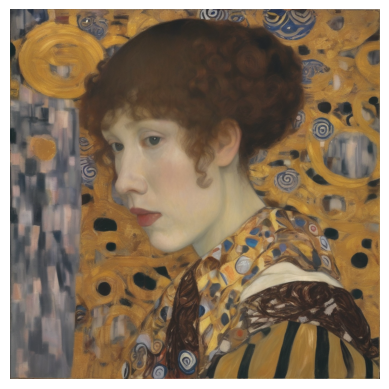

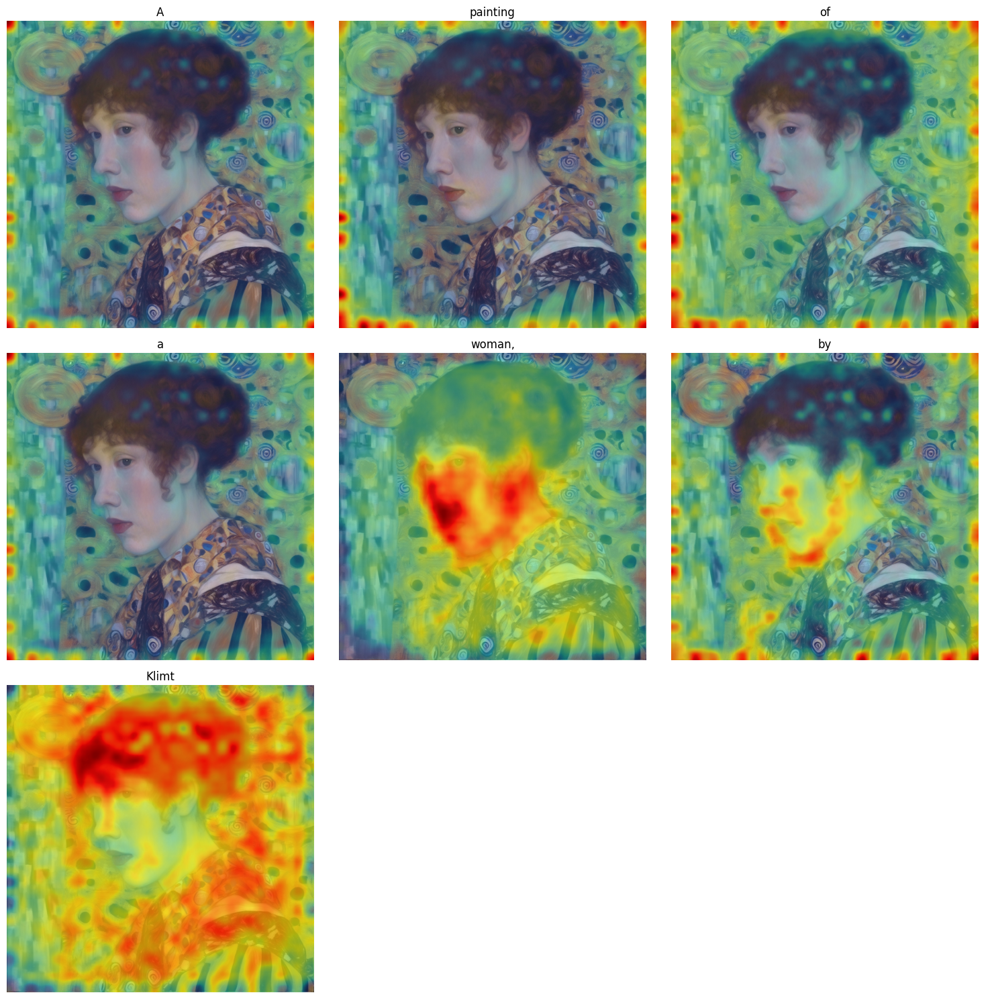

In [ ]:
prompt = "A painting of a woman, by Klimt"
generate_and_visualize_heat_map(pipe, gen, prompt)

100%|██████████| 50/50 [01:28<00:00,  1.77s/it]


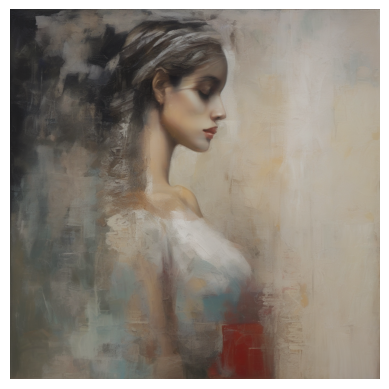

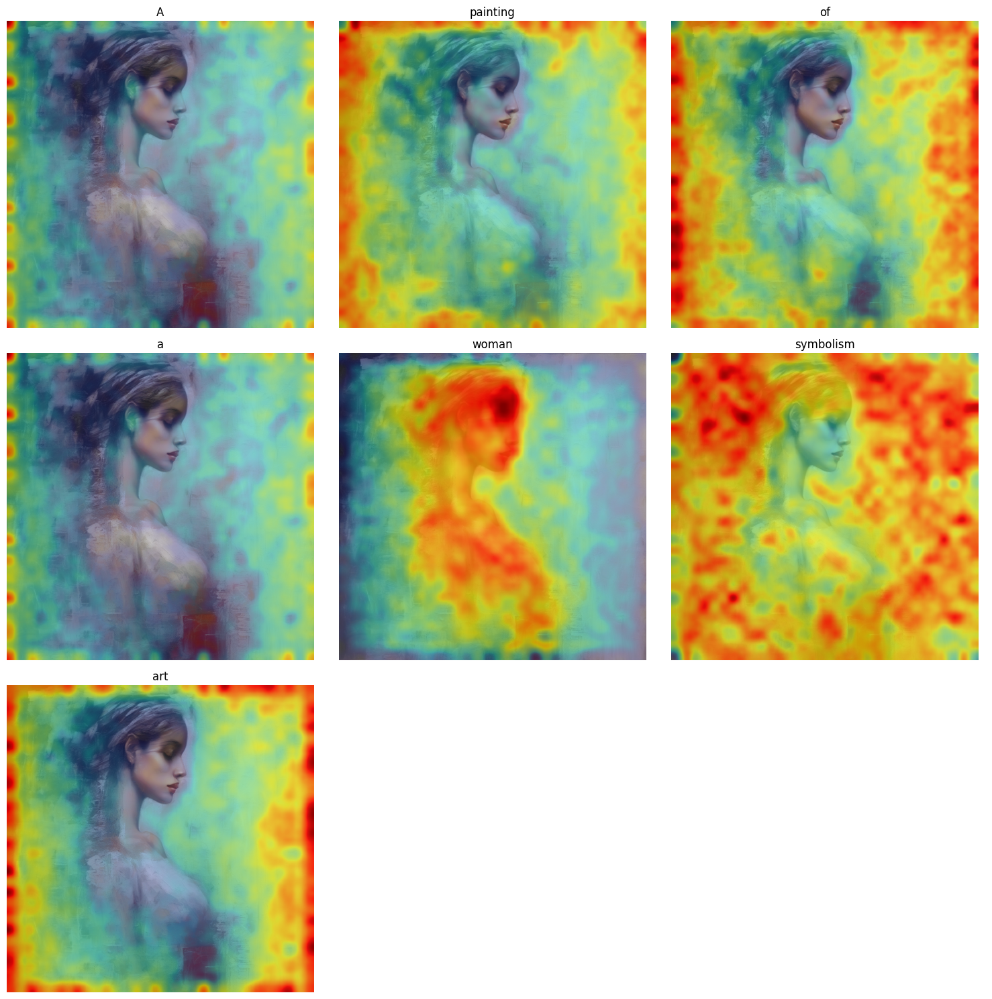

In [ ]:
prompt = "A painting of a woman symbolism art"
generate_and_visualize_heat_map(pipe, gen, prompt)

/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)


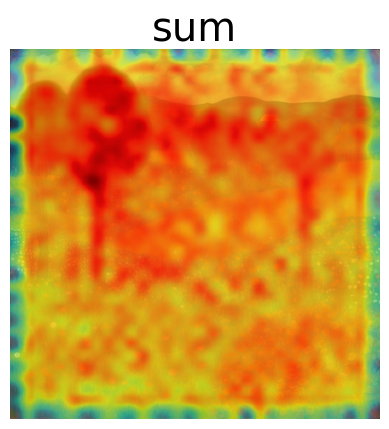

In [ ]:
from daam.heatmap import WordHeatMap

h_sum = WordHeatMap(word="sum", word_idx=999, heatmap=heatmaps[-1].value + heatmaps[-3].value)
h_sum.plot_overlay(out.images[0], color_normalize=False)
plt.axis('off')
plt.show()

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:45<00:00,  2.11s/it]


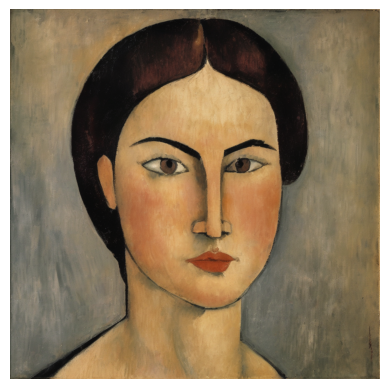

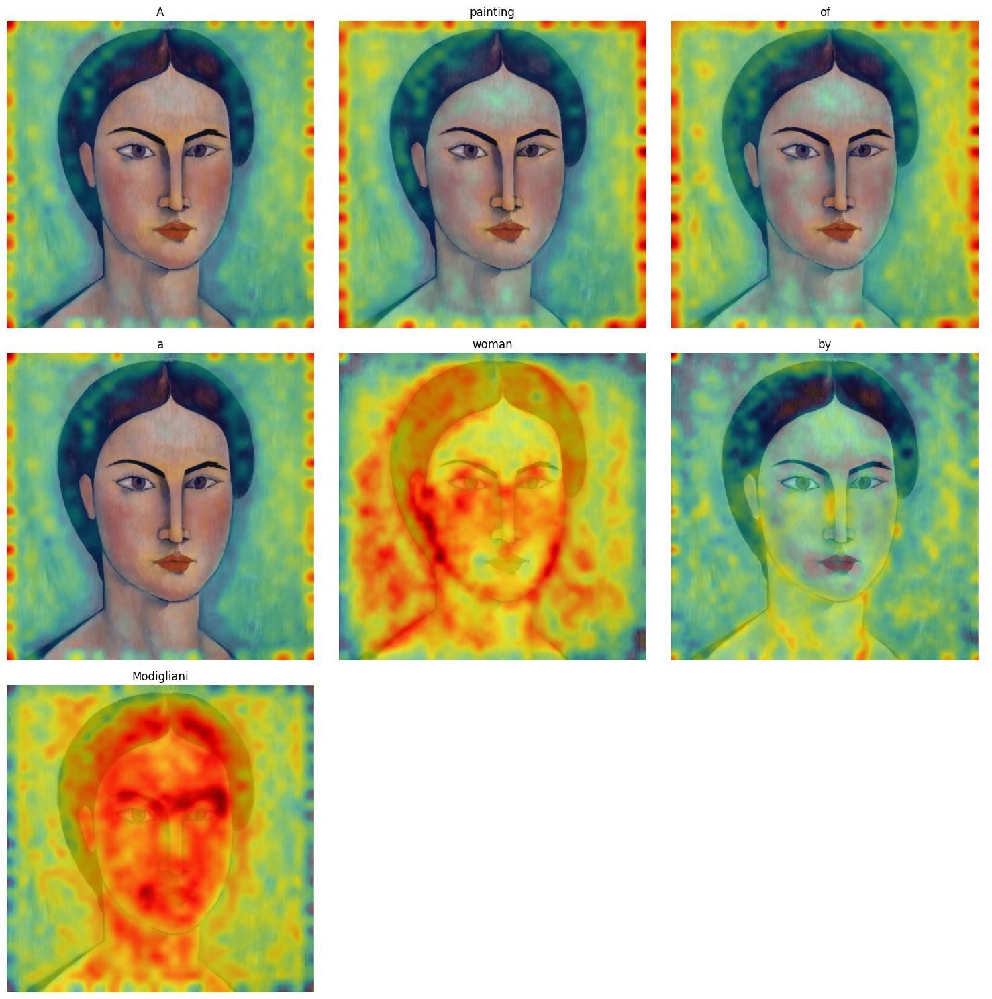

In [ ]:
prompt = "A painting of a woman by Modigliani"
generate_and_visualize_heat_map(pipe, gen, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:57<00:00,  2.35s/it]


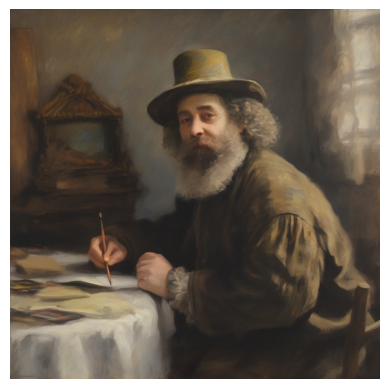

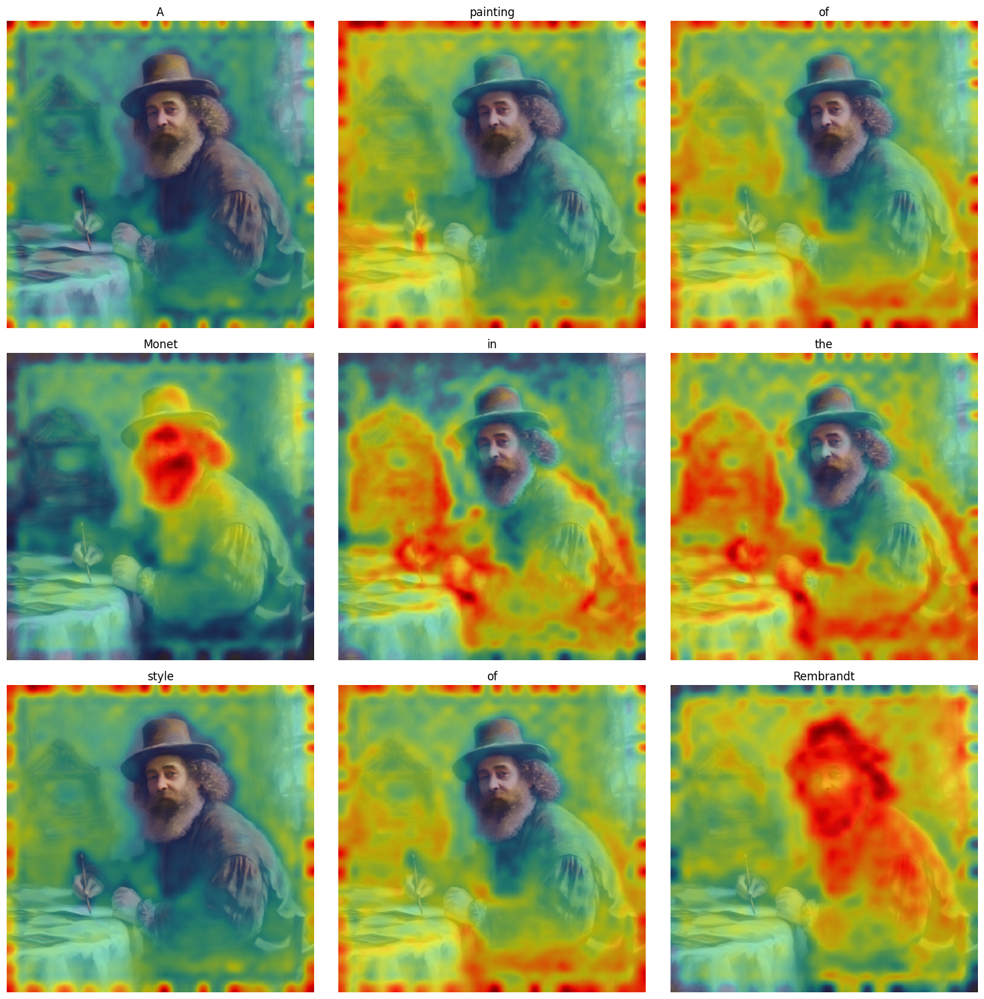

In [ ]:
prompt = "A painting of Monet in the style of Rembrandt"
generate_and_visualize_heat_map(pipe, gen, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:34<00:00,  1.89s/it]


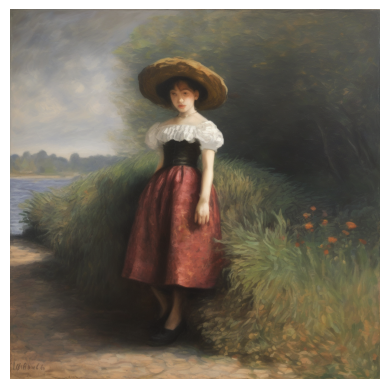

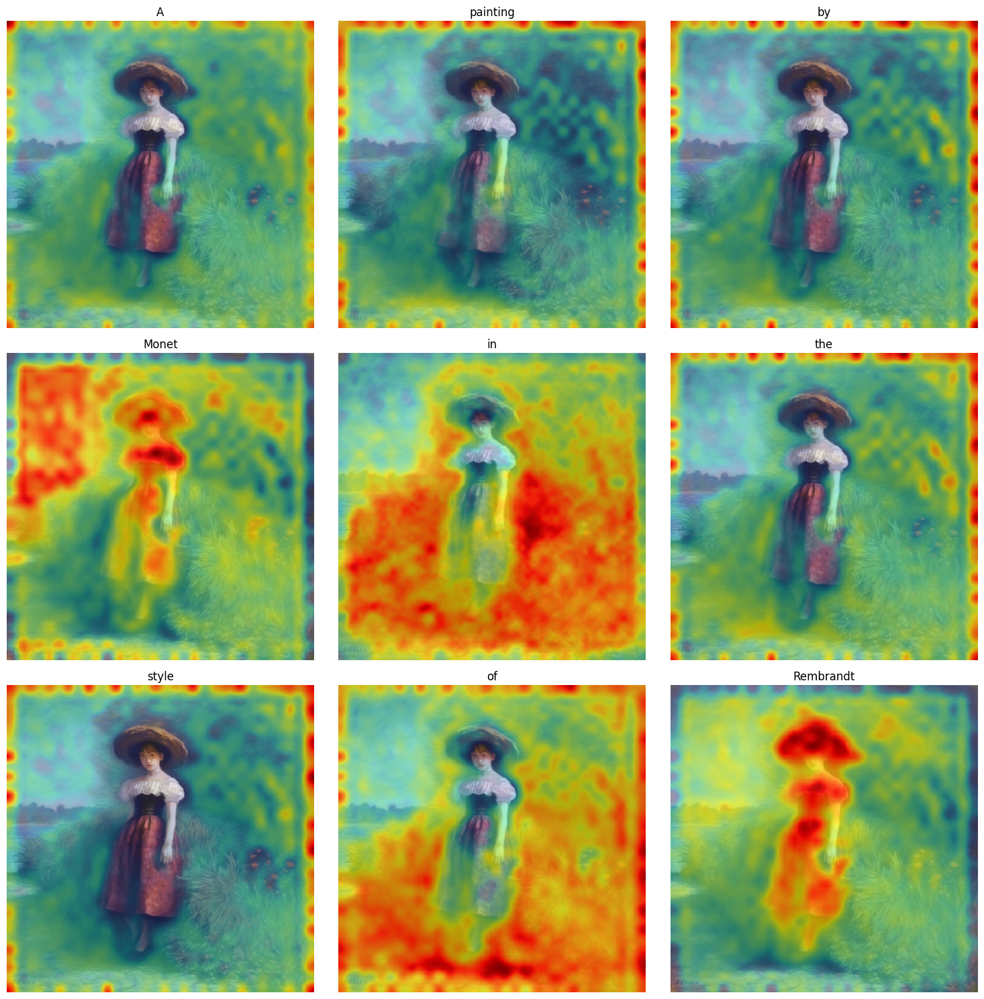

In [ ]:
prompt = "A painting by Monet in the style of Rembrandt"
generate_and_visualize_heat_map(pipe, gen, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:34<00:00,  1.90s/it]


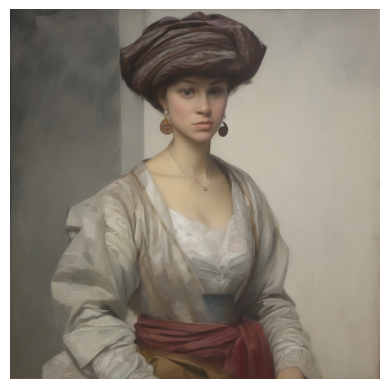

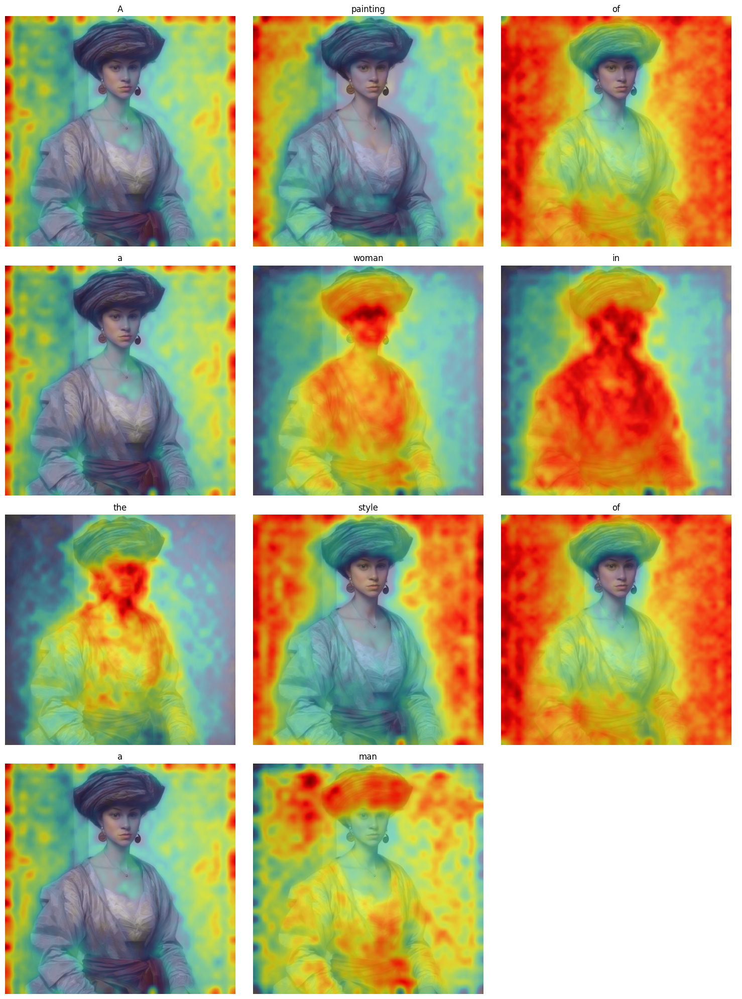

In [ ]:
prompt = "A painting of a woman in the style of a man"
generate_and_visualize_heat_map(pipe, gen, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]/Users/sergiopicascia/.pyenv/versions/3.11.5/envs/daam/lib/python3.11/site-packages/daam/utils.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  return torch.cuda.amp.autocast(*args, **kwargs)
100%|██████████| 50/50 [01:49<00:00,  2.20s/it]


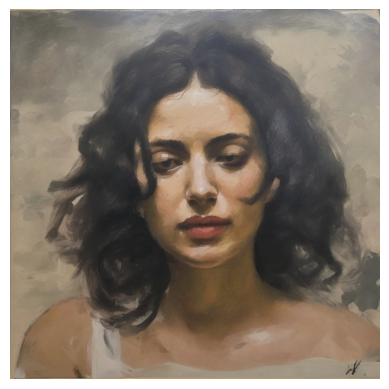

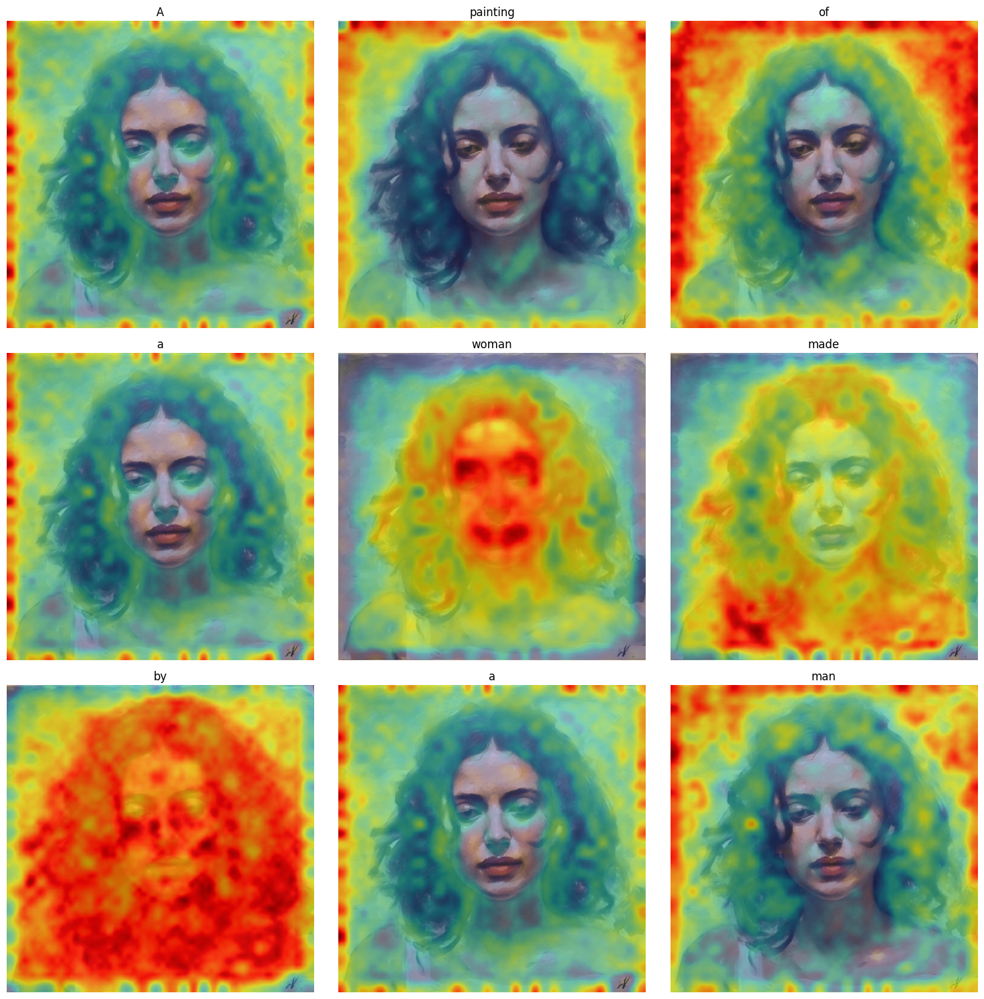

In [ ]:
prompt = "A painting of a woman made by a man"
generate_and_visualize_heat_map(pipe, gen, prompt)